## Wmm lab 4 – przetwarzanie obrazów
Patryk Zdziech\
Nr a 311028

# Informacje wstępne
## Biblioteki:

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

## Użyty obrazek

311028 % 36 = 24


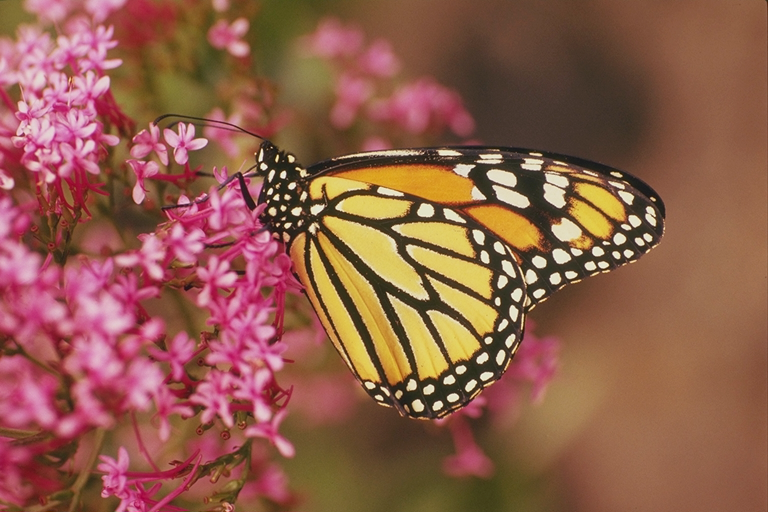

In [ ]:
print(f"311028 % 36 = {311028 % 36}") # monarch_col.png

data_dir = "/content/sample_data/"

image_col = cv2.imread(data_dir+"monarch_col.png", cv2.IMREAD_UNCHANGED)
cv2_imshow(image_col)

# Zad1
Każdy z obrazów wejściowych poddać przetwarzaniu filtrem wygładzającym (Gaussa) i filtrem
medianowym. Wyświetlić i obliczyć PSNR.

In [ ]:
def calcPSNR(img1, img2):
    imax = 255.**2
    mse = ((img1.astype(np.float64)-img2)**2).sum()/img1.size
    return 10.0*np.log10(imax/mse)

def show_gausian_blur(mask_size,image):
    gaussian_blur_image = cv2.GaussianBlur(image, (mask_size,mask_size), 0)
    PSNR = calcPSNR(image_col, gaussian_blur_image)
    desc = f'\nGaussian blur ({mask_size},{mask_size})\t PSNR: {PSNR}\n'
    print(desc)
    cv2_imshow(gaussian_blur_image)

def show_median_blur(mask_size,image):
    median_blur_image = cv2.medianBlur(image, mask_size)
    PSNR = calcPSNR(image_col, median_blur_image)
    desc = f'\nMedian blur ({mask_size},{mask_size})\t PSNR: {PSNR}\n'
    print(desc)
    cv2_imshow(median_blur_image)

def show_blured_images(input_image_name, blur_func):
    image = cv2.imread(data_dir+input_image_name, cv2.IMREAD_UNCHANGED)
    print(f"\ninput image {input_image_name}:\n")
    cv2_imshow(image)
    for mask_size in [3,5,7]:
        blur_func(mask_size,image)

## Obraz z szumem gaussowskim
* Filtr Gaussa:


input image monarch_col_noise.png:



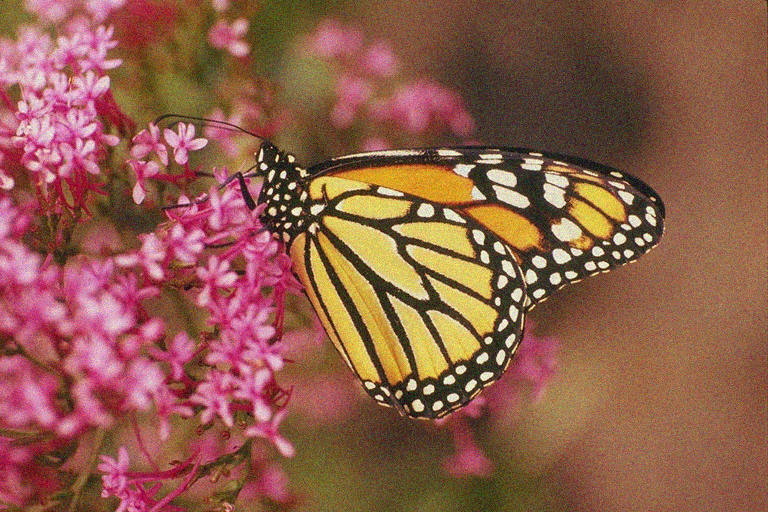


Gaussian blur (3,3)	 PSNR: 30.520590131084138



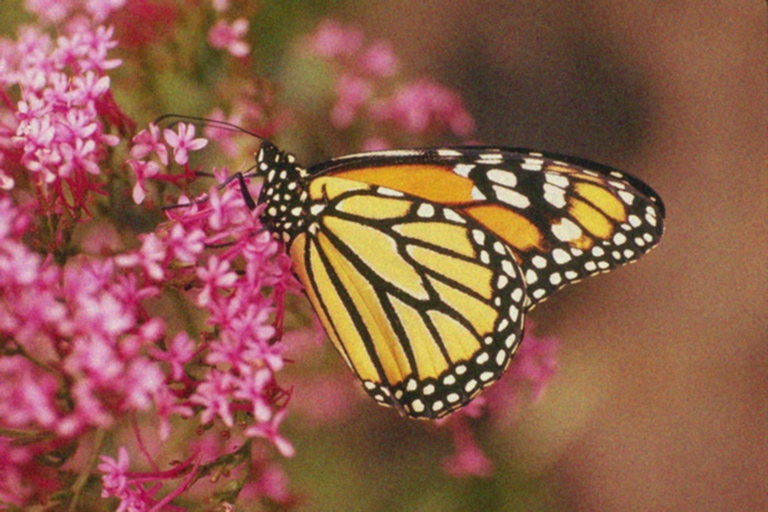


Gaussian blur (5,5)	 PSNR: 29.40232994239979



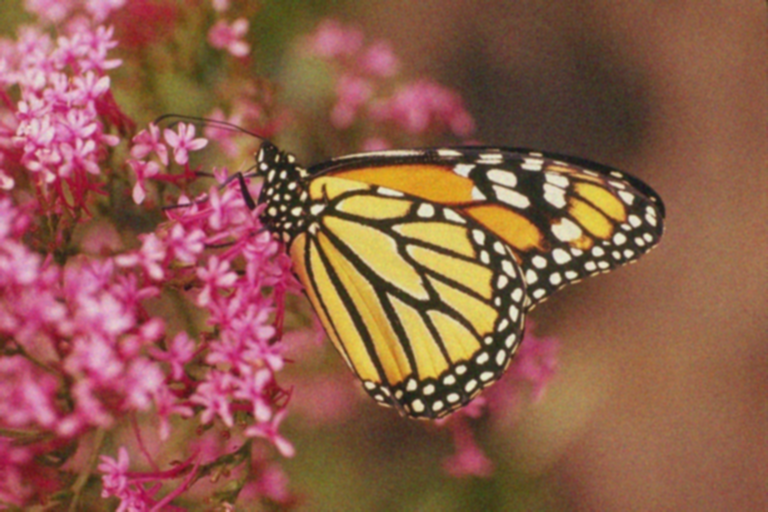


Gaussian blur (7,7)	 PSNR: 27.63176768308697



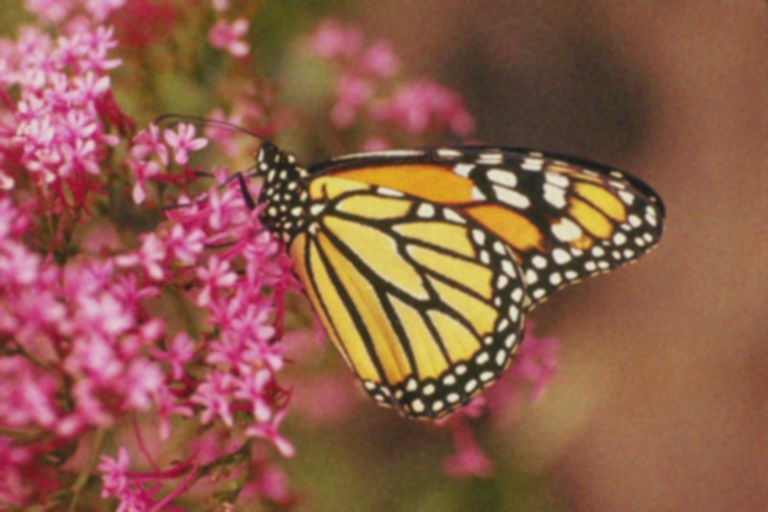

In [ ]:
show_blured_images("monarch_col_noise.png",show_gausian_blur)

* Filtr medianowy:


input image monarch_col_noise.png:



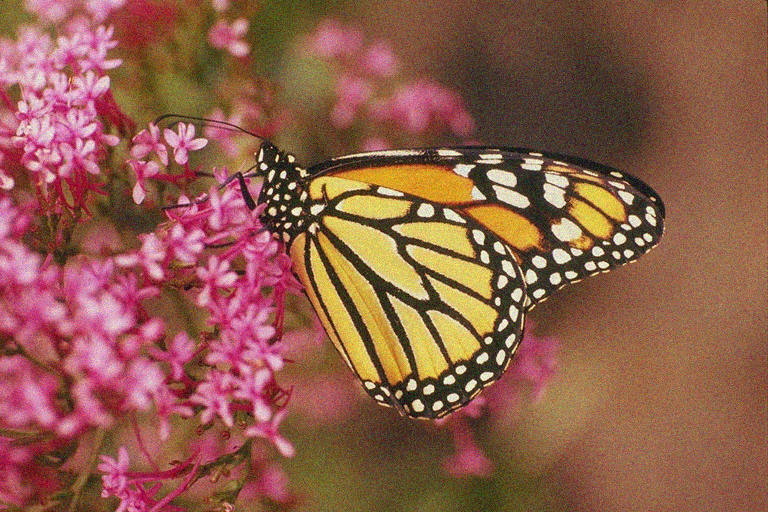


Median blur (3,3)	 PSNR: 30.16075562066068



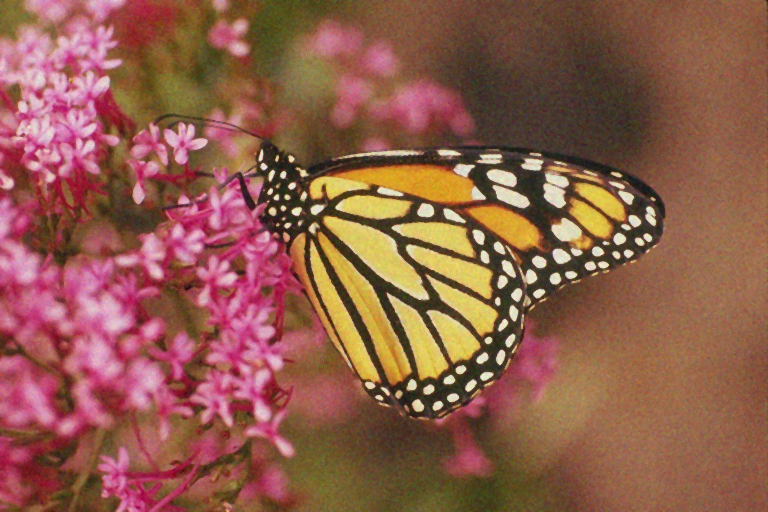


Median blur (5,5)	 PSNR: 28.43524455666651



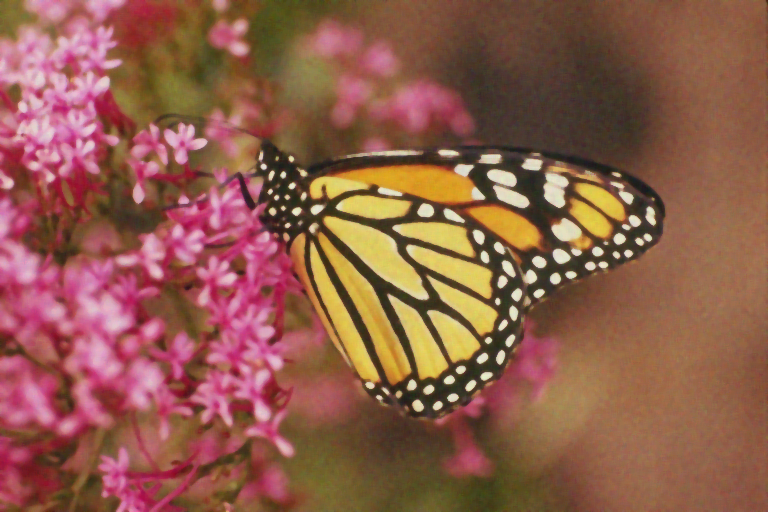


Median blur (7,7)	 PSNR: 26.188127771141446



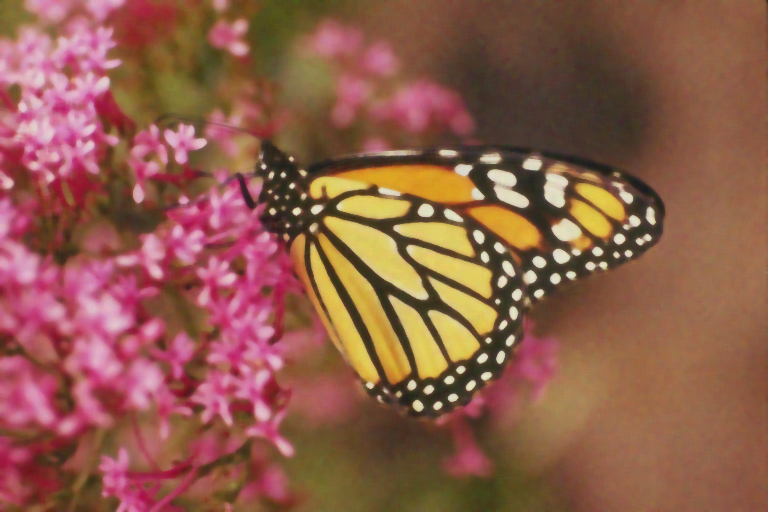

In [ ]:
show_blured_images("monarch_col_noise.png",show_median_blur)

* Porównanie wyników:\
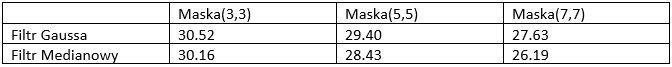\
Według wskaźnika PSNR oba filtry sprawdziły się dobrze z maską 3x3. Filtr Gaussa trochę lepiej od medianowego. Sądzę że ta ocena dobrze oddaje efekt wizualny. Zakłócenia były na tyle niewielkie, że zastosowanie filtra z małą maską 3x3 w zupełności wystarczyło, podczas gdy większa maska niepotrzebnie rozmywała obraz.

## Obraz z szumem impulsowym
* Filtr Gaussa


input image monarch_col_inoise.png:



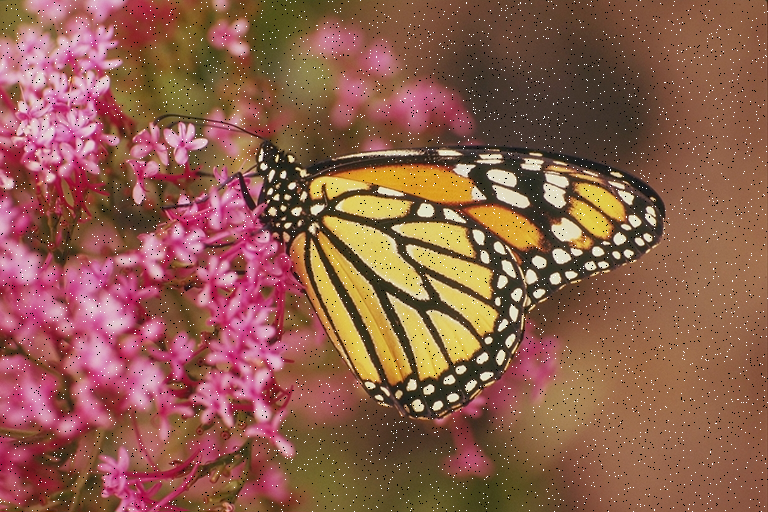


Gaussian blur (3,3)	 PSNR: 28.391876360617697



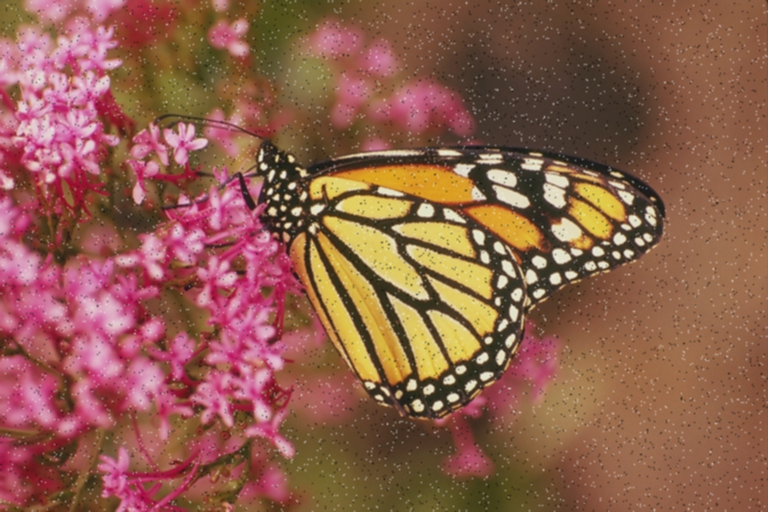


Gaussian blur (5,5)	 PSNR: 28.279144404338716



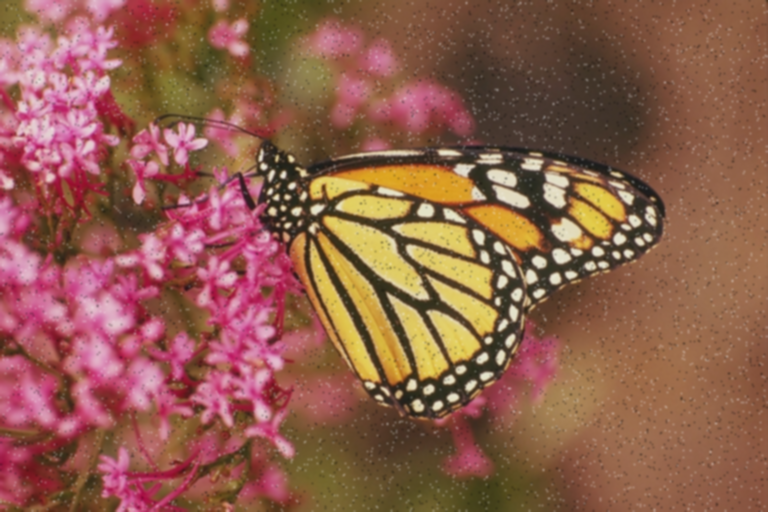


Gaussian blur (7,7)	 PSNR: 27.087013005718536



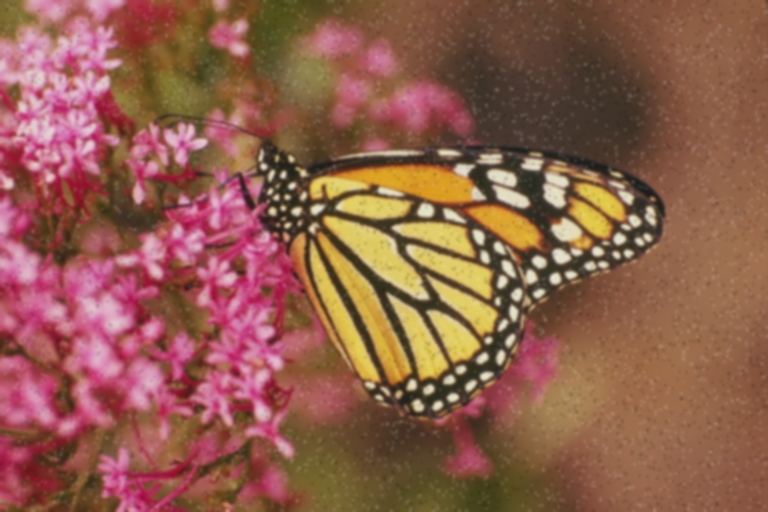

In [ ]:
show_blured_images("monarch_col_inoise.png",show_gausian_blur)

* Filtr medianowy:


input image monarch_col_inoise.png:



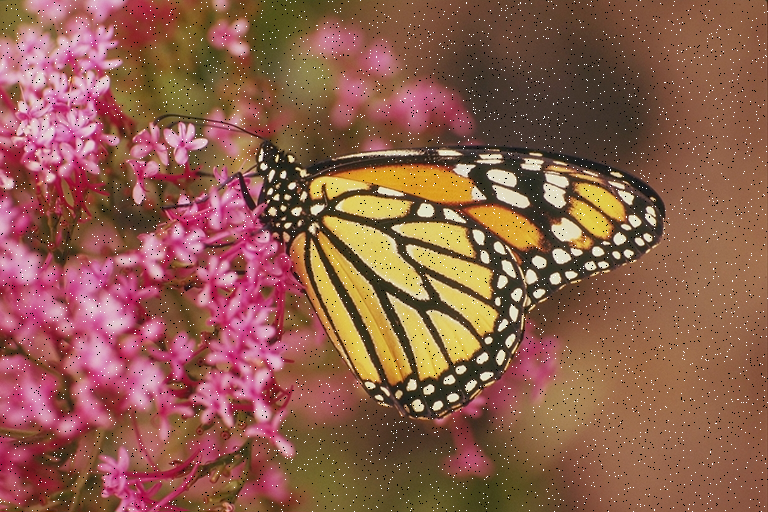


Median blur (3,3)	 PSNR: 34.18839417337081



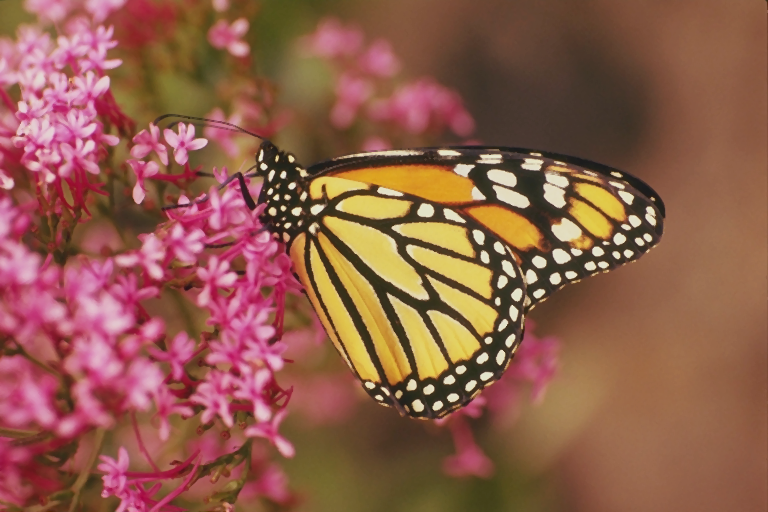


Median blur (5,5)	 PSNR: 29.329862517838798



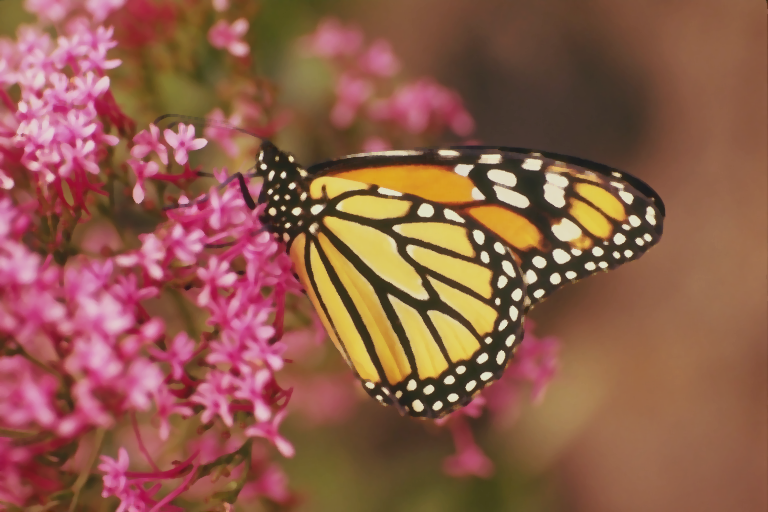


Median blur (7,7)	 PSNR: 26.474429636935252



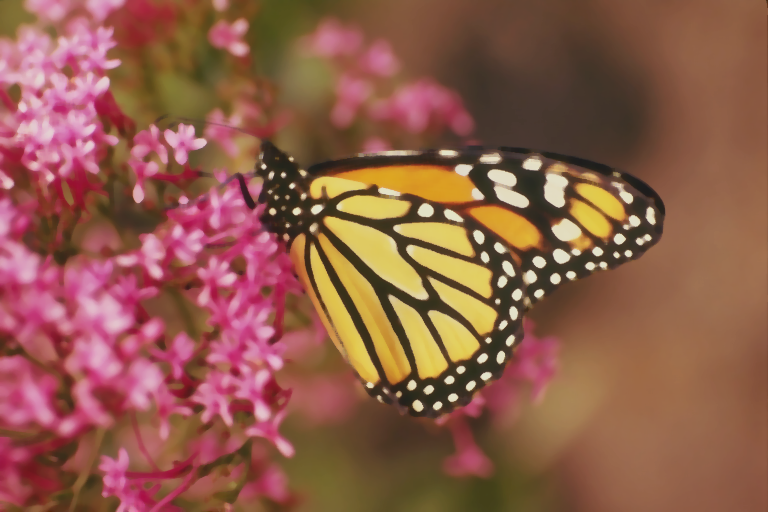

In [ ]:
show_blured_images("monarch_col_inoise.png",show_median_blur)

* Porównanie wyników:\
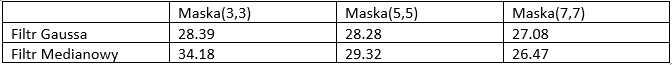\
Według wskaźnika PSNR najlepiej poradził sobie filtr medianowy z małą maską. Jest to prawda, jednak wskaźnik PSNR nie oddaje tego że filtr Gaussa w ogólności daje dużo gorsze rezultaty wizualne dla tego obrazka. Filtr medianowy bardzo dobrze poradził sobie z usunięciem pojedynczych niepasujących pikseli, podczas gdy filtr Gaussa jedynie je rozmył.

# Zad2
Zrealizować operację wyrównania histogramu dla obrazu barwnego

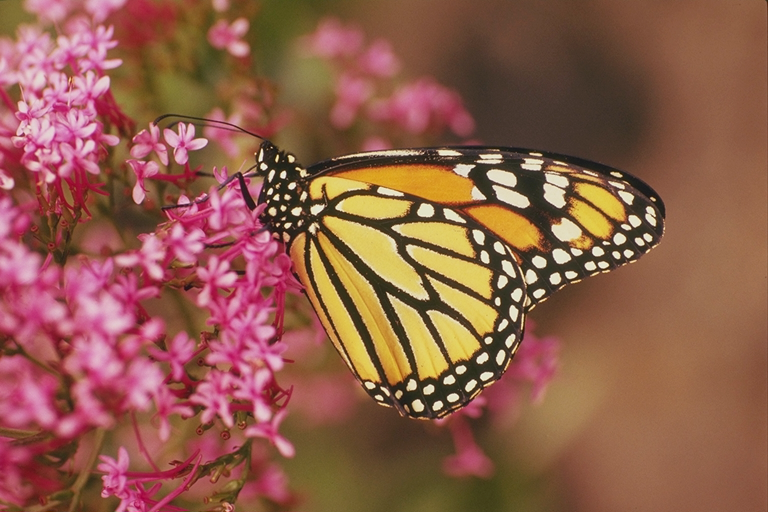

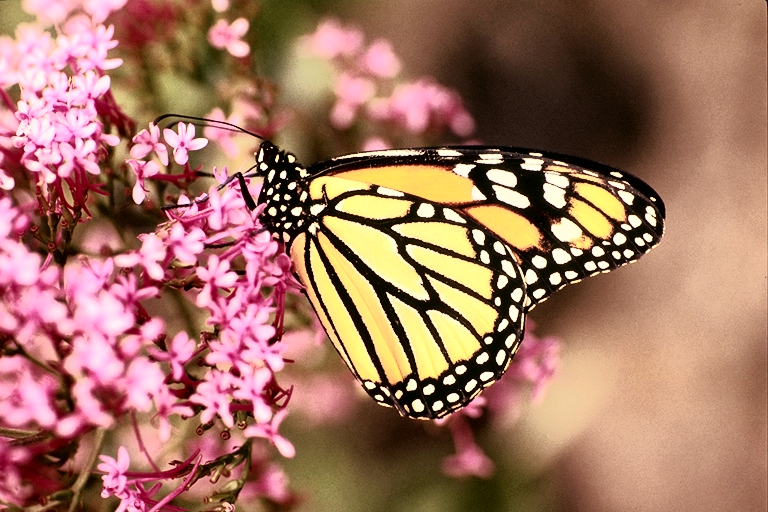

In [ ]:
image_eql = cv2.cvtColor(image_col, cv2.COLOR_BGR2YCrCb)
image_eql[:, :, 0] = cv2.equalizeHist(image_eql[:, :, 0])
image_eql = cv2.cvtColor(image_eql, cv2.COLOR_YCrCb2BGR)

#cv2.imwrite(data_dir+"image_eql.png", image)

cv2_imshow(image_col);
cv2_imshow(image_eql);

## Ocena efektu
Po wyrównaniu składowej jasności obraz jest bardziej wyrazisty, ponieważ zwiększyła się różnica pomiedzy elementami jasnymi i ciemnymi. Kolory jednak straciły na intensywności co sprawia że obraz nie wygląda naturalnie.

## Porównanie histogramów:

input image histogram:


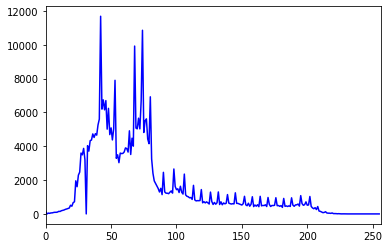

equalized image histogram:


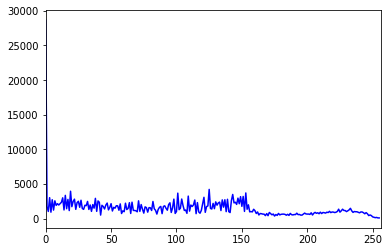

In [ ]:
def show_histogram(image):
    hist_cv = cv2.calcHist([image], [0], None, [256], [0, 256])
    hist_cv = hist_cv.flatten()
    plt.figure()
    plt.plot(hist_cv, color="blue")
    plt.xlim([0, 256])
    plt.show()
print("input image histogram:")
show_histogram(image_col)
print("equalized image histogram:")
show_histogram(image_eql)

# Zad3
Korzystając z filtru Laplace’a do wyznaczenia wysokoczęstotliwościowych składowych obrazu
dokonać wyostrzenia obrazu.

used weight: 0


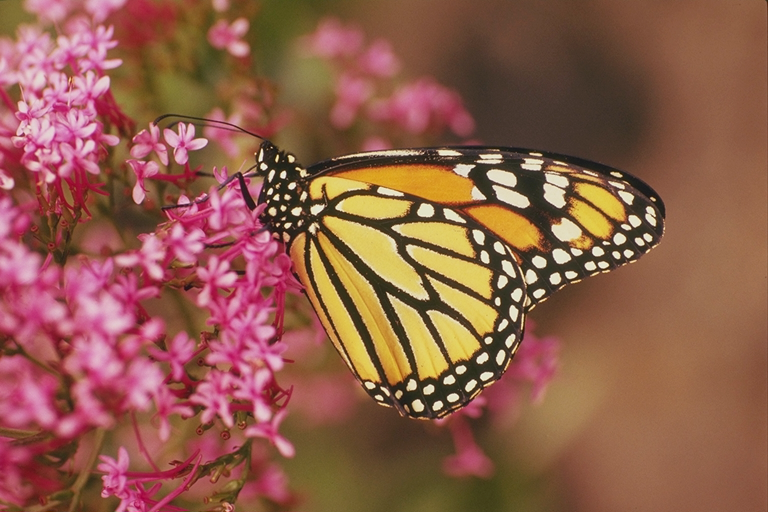

used weight: 0.5


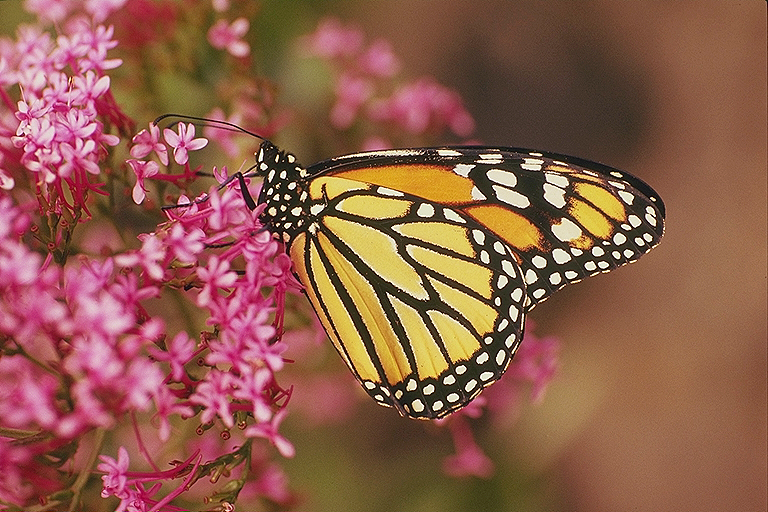

used weight: 1


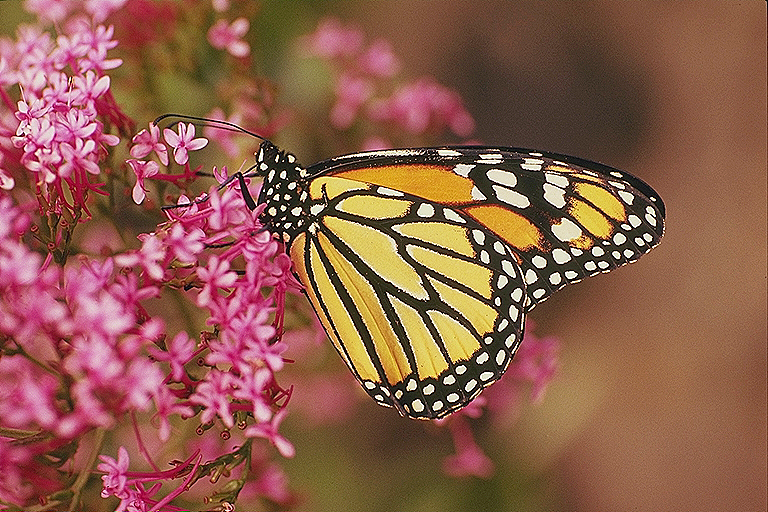

used weight: 2


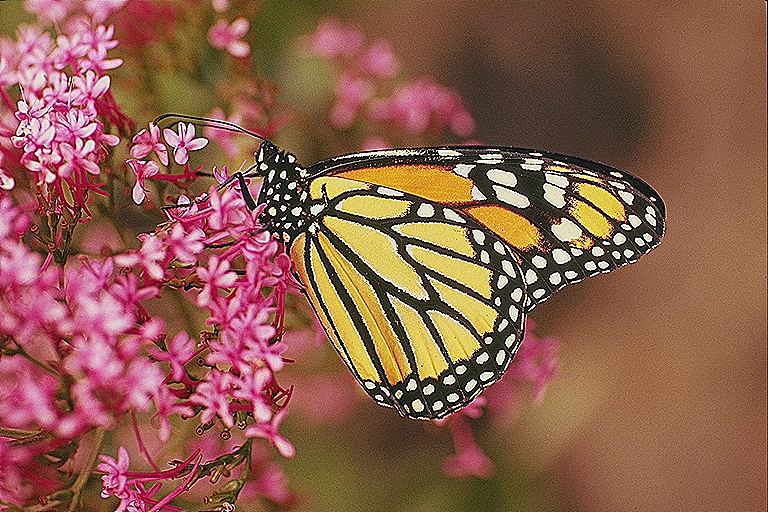

In [ ]:
def show_sharpened_image(image, weight):
    print(f"used weight: {weight}")
    image_lapl = cv2.Laplacian(image, cv2.CV_64F)
    image = np.asarray(image, np.float64)
    output_image = cv2.addWeighted(image, 1, image_lapl, -weight, 0)
    cv2_imshow(output_image)

show_sharpened_image(image_col, 0)
show_sharpened_image(image_col, 0.5)
show_sharpened_image(image_col, 1)
show_sharpened_image(image_col, 2)

* Z filtrem Gaussa:

used weight: 0


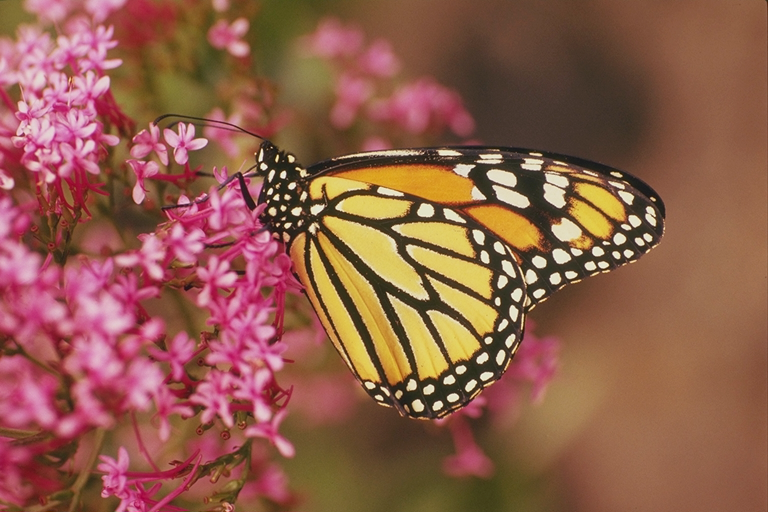

used weight: 0.5


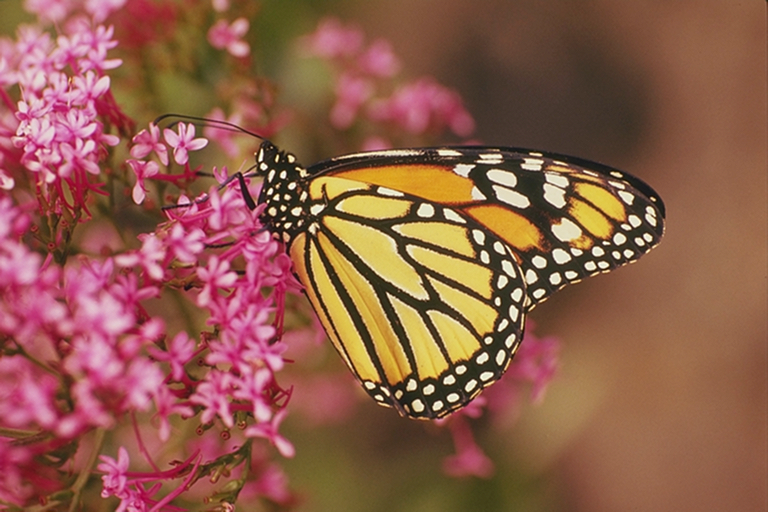

used weight: 1


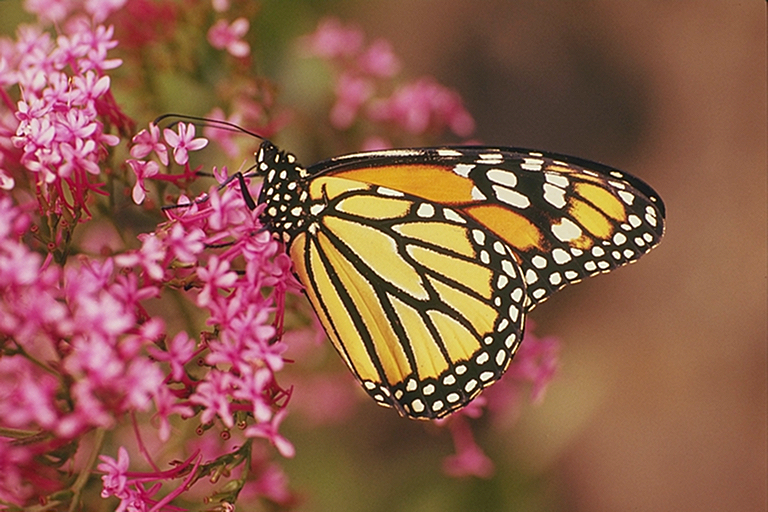

used weight: 2


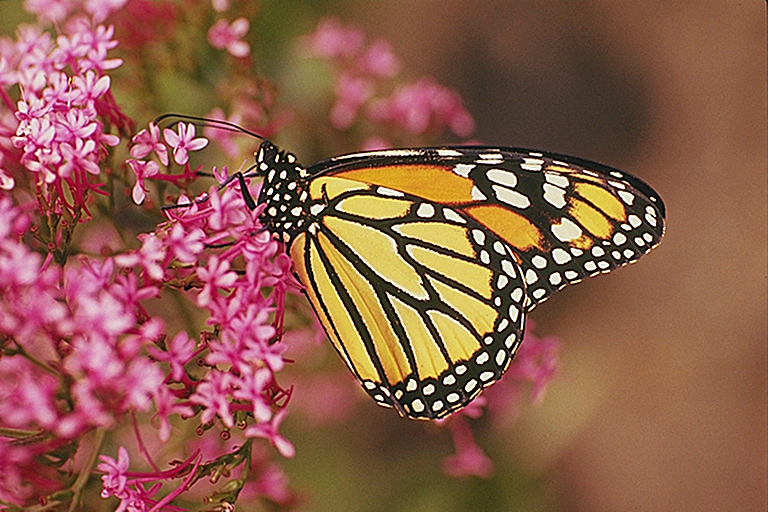

In [ ]:
gaussian_blur_image = cv2.GaussianBlur(image_col, (3,3), 0)
show_sharpened_image(image_col, 0)
show_sharpened_image(gaussian_blur_image, 0.5)
show_sharpened_image(gaussian_blur_image, 1)
show_sharpened_image(gaussian_blur_image, 2)

## Wnioski
Wagi składowej wysokoczęstotliwościowej wpływa na ostrość krawędzi. Zbyt duża ostrość krawędzi sprawia że obraz traci głębie i wydaje się płaski. Dla wagi 0.5 obraz nadal pozostaje przyjemny do oglądania. Można też zastosować wagę 1 przy wcześniejszym użyciu filtra Gaussa. Dla wyższych wag obraz traci część walorów estetycznych.